<a href="https://colab.research.google.com/github/Timo-Asif/Animated-Fluids/blob/main/Animated_Fluids.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Mesh Setup

In [4]:
import math
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import scipy.optimize as so

from matplotlib import rcParams
import sys, os, math, tempfile, atexit, shutil
from joblib import Parallel, delayed
rcParams['text.usetex'] =False
rcParams['text.latex.preamble'] = [
    r'\usepackage{amsmath}',
    r'\usepackage{amssymb}']
rcParams['font.family'] = 'serif'
# rcParams['font.serif'] = 'Computer Modern'


Lx = 3
Ly = 3
Rmax = 10
Nx = 40
Ny = 40
Nr = 200
Nt = 200
x = np.linspace(-Lx, Lx, Nx)
y = np.linspace(-Ly, Ly, Ny)
r = np.linspace(1, Rmax, Nr)
t = np.linspace(1e-3, 2*np.pi-1e-3, Nt)

X, Y = np.meshgrid(x,y)
R, T = np.meshgrid(r,t)
Z = X+1j*Y
Zr = R*np.exp(1j*T)

#Initial Plot Setup

In [5]:
c = [
    '#08F7FE',  # teal/cyan
    '#FE53BB',  # pink
    '#F5D300',  # yellow
    '#00ff41', # matrix green
]


def analytic_sol(p):
    v = ((p)+math.sqrt(((p)**2 + (p)*math.sqrt((p)**2 +4))/2))+(1+math.sqrt((-(p)**2 + (p)*math.sqrt((p)**2 +4))/2))*1j
    vbar = ((p)+math.sqrt(((p)**2 + (p)*math.sqrt((p)**2 +4))/2))-(1+math.sqrt((-(p)**2 + (p)*math.sqrt((p)**2 +4))/2))*1j
    Gamma = (np.pi*1j)/2 * ((v-1j)*(vbar-1j)*(v+1j)*(vbar+1j))/((v-vbar)*(v*vbar-1))
    epsilon = 0.0
    W = 1/4 *(Zr + 1/(Zr)) + 1j*Gamma/(2*np.pi)*(np.log(Zr - v)-np.log(Zr - vbar)+np.log(Zr - 1/(v))-np.log(Zr - 1/(vbar))+np.log((vbar)/(v)))
    return v, vbar, Gamma, epsilon, W

def fill_contours(X, Y, W, Zeta, rc, epsilon, psilevels):
    rc = 1 + 0*t
    #philevels = np.linspace(-1*np.pi, 1*np.pi, 300)
    psilevels = np.linspace(-1*np.pi, 1*np.pi, 700)
    #ax1.contour(X, Y, W.real, levels=philevels, colors='r', linewidths=0.5)

    # Contour Lines Axis 1
    ax1.contour(X, Y, W.imag, levels=psilevels, colors=c[0], linewidths=0.5, alpha = 0.4)

    # Vortices
    ax1.contour(X, Y, W.imag, levels=[0], colors=c[1], linewidths=2, alpha=0.8)

    # Cylinder + Boundary
    ax1.fill(rc*np.cos(t), rc*np.sin(t), color='white', alpha=0.2)
    ax1.plot(rc*np.cos(t), rc*np.sin(t),color= 'white',linewidth=5)

    # Contour Lines Axis 2
    #ax2.contour(Zeta.real, Zeta.imag, W.real, levels=philevels, colors='r', linewidths=0.5)
    ax2.contour(Zeta.real, Zeta.imag, W.imag, levels=psilevels, colors=c[0], linewidths=0.5, alpha=0.4)

    # Vortices
    ax2.contour(Zeta.real, Zeta.imag, W.imag, levels=[0], colors=c[1], linewidths=2, alpha=0.8)

    # Plate
    ax2.fill((1/2)*epsilon*rc*np.cos(t), (1/2)*rc*np.sin(t), color='white', alpha=1, linewidth=5)
    ax2.plot((1/2)*epsilon*rc*np.cos(t), (1/2)*rc*np.sin(t),color= 'white')

def set_axis():
    ax1.axis('scaled')
    ax2.axis('scaled')

    ax1.set_xlim([-2,2])
    ax1.set_ylim([-2,2] )
    ax2.set_xlim([-0.5,0.5] )
    ax2.set_ylim([0,1.0] )

    ax1.set_xlabel('$\\xi$', fontsize=15)
    ax1.set_ylabel('$\\eta$', fontsize=15)
    ax2.set_xlabel('$x$', fontsize=15)
    ax2.set_ylabel('$y$', fontsize=15)
    plt.setp(ax1.get_xticklabels(), visible=True,fontsize=15)
    plt.setp(ax2.get_xticklabels(), visible=True, fontsize=15)
    plt.setp(ax1.get_yticklabels(), visible=True,fontsize=15)
    plt.setp(ax2.get_yticklabels(), visible=True, fontsize=15)
    ax1.tick_params(axis='x', pad=10)
    ax1.tick_params(axis='y', pad=10)
    ax2.tick_params(axis='x', pad=10)
    ax2.tick_params(axis='y', pad=10)
    

## Plot Setup

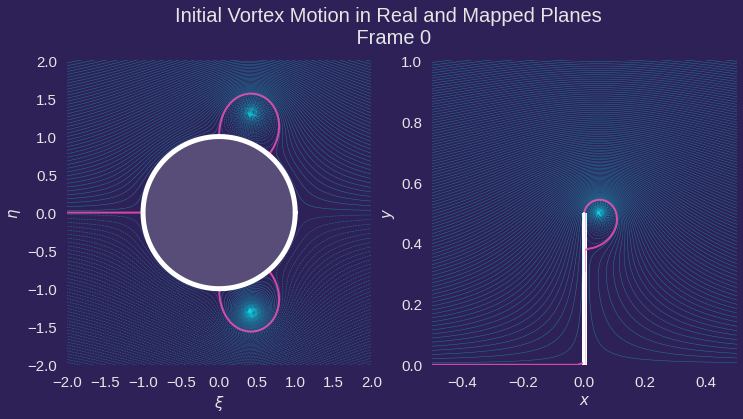

In [9]:
from matplotlib import animation
import matplotlib.pyplot as plt


plt.style.use("seaborn-dark")

for param in ['figure.facecolor', 'axes.facecolor', 'savefig.facecolor']:
    plt.rcParams[param] = '#2e2157'  # bluish dark grey

for param in ['text.color', 'axes.labelcolor', 'xtick.color', 'ytick.color']:
    plt.rcParams[param] = '0.9'  # very light grey

#ax.grid(color='#2A3459')  # bluish dark grey, but slightly lighter than background

# Set Axes for initial plot (may be unnecessary)
fig = plt.figure(1, figsize=(12,6))
tx = fig.suptitle('Initial Vortex Motion in Real and Mapped Planes \n ' + 'Frame 0', fontsize=20)
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)

v, vbar, Gamma, epsilon, W = analytic_sol(0.1)
X = Zr.real
Y = Zr.imag
Zeta = (1/4)*(Zr - 1/(Zr))

rc = 1 + 0*t
#philevels = np.linspace(-1*np.pi, 1*np.pi, 300)
psilevels = np.linspace(-1*np.pi, 1*np.pi, 700)

fill_contours(X, Y, W, Zeta, rc, epsilon, psilevels)


set_axis()

#Animation Function

In [10]:
def animate(p):
    tx.set_text('Initial Vortex Motion in Real and Mapped Planes \n' + 'Frame {0}'.format(p))
    # print('Frame {0} Rendering'.format(p))
    p = 2*(p+1)/100

    # Reset Axes
    ax1.clear()
    ax2.clear()

    set_axis()
    # Maths
    v, vbar, Gamma, epsilon, W = analytic_sol(p)
    X = Zr.real
    Y = Zr.imag
    Zeta = (1/4)*(Zr - 1/(Zr))

    rc = 1 + 0*t
    #philevels = np.linspace(-1*np.pi, 1*np.pi, 300)
    psilevels = np.linspace(-1*np.pi, 1*np.pi, 700)
    #ax1.contour(X, Y, W.real, levels=philevels, colors='r', linewidths=0.5)
    fill_contours(X, Y, W, Zeta, rc, epsilon, psilevels)
    

## Create Animation and GIF

In [15]:
# Create Animation
gif_title = 'animation60.gif'

# Frame Settings (only for jupyter display)
slow_motion_factor = 2
fps = 50
interval = 1 / fps

anim = animation.FuncAnimation(fig, animate, frames=60, 
                     interval= 1000 * interval * slow_motion_factor, 
                     blit=False)
plt.show()

# Save as gif file (set fps for gif here)
anim.save(gif_title, writer = "pillow", fps=15)

#Jupyter Notebook/Colab inline animations
plt.rcParams['animation.html'] = 'jshtml'
anim

Animation size has reached 21210331 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
